In [1]:
import pandas as pd
uiks = pd.read_csv('data/edata.csv', index_col=0)
uiks

,name,region,kprf,er,voted,total_voters,lat,lon
0,УИК №592,Алтайский край,57,49,178,385,51.885025,85.307478
1,УИК №593,Алтайский край,189,174,569,1515,51.934707,85.326494
2,УИК №594,Алтайский край,157,141,464,1175,51.930130,85.333621
3,УИК №595,Алтайский край,303,339,962,2257,51.943233,85.336853
4,УИК №596,Алтайский край,264,282,843,1924,51.961639,85.335227
...,...,...,...,...,...,...,...,...
96302,УИК №187,город Севастополь,261,791,1586,2286,44.773268,33.544332
96303,УИК №188,город Севастополь,111,431,905,1589,44.773268,33.544332
96304,УИК №189,город Севастополь,112,306,634,1333,44.815350,33.560437
96305,УИК №190,город Севастополь,145,346,660,1235,44.786191,33.616072


In [2]:
kprf = uiks['kprf'].sum()/uiks['voted'].sum()
kprf

0.18925488494610923

In [3]:
er = uiks['er'].sum()/uiks['voted'].sum()
er

0.4982132868119814

In [4]:
uiks = uiks[uiks['kprf']>10]
uiks = uiks[uiks['er']>10]
uiks['k-e'] = 0.0
regions = uiks['region'].drop_duplicates()
reg = pd.DataFrame()
for region in regions:
   region_data = uiks[uiks['region'] == region]
   voted = region_data['voted'].sum()
   kprf_total = region_data['kprf'].sum()
   kprf_percent = kprf_total/voted
   er_total = region_data['er'].sum()
   er_percent = er_total/voted
   uiks.loc[uiks['region'] == region, 'k-e'] = kprf_percent-er_percent
   if er_total>kprf_total:
       uiks.loc[uiks['region'] == region, 'color'] = 'blue'
   else:
       uiks.loc[uiks['region'] == region, 'color'] = 'red'
   reg = reg.append(pd.DataFrame({'name': region,'kprf':[kprf_total], 'kprf_percent':[kprf_percent],'er':[er_total],'er_percent':[er_percent]}), ignore_index=True)
reg[reg['kprf']>reg['er']]
len(uiks['k-e'])

87810

In [5]:
import plotly.express as px
fig = px.scatter_mapbox(uiks, #our data set
                        lat="lat",
                        lon="lon",
                        color="k-e",
                        range_color = (-0.5,0.5),
                        zoom=2,
                        width=1200, height=800,
                        center = {'lat':60,'lon':105},
                        title =  'По данным ЦИК')
fig.update_layout(mapbox_style="open-street-map")
fig.update_traces(marker=dict(size=5))
fig.show(config={'scrollZoom': True})
fig.write_image("initial.png")

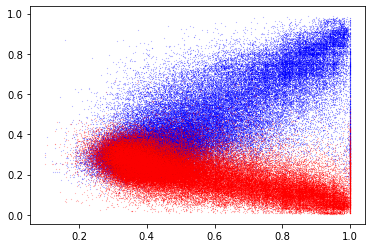

In [6]:
import matplotlib.pyplot as plt
uiks['er_percent'] = uiks['er'] / (uiks['voted'])
uiks['kprf_percent'] = uiks['kprf'] / (uiks['voted'])
uiks['turnout'] = uiks['voted']/uiks['total_voters']
plt.scatter(uiks['turnout'], uiks['er_percent'], color='blue', s=0.01)
plt.scatter(uiks['turnout'], uiks['kprf_percent'], color='red', s=0.01)
plt.show()

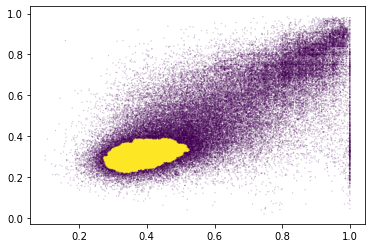

In [7]:
from sklearn.cluster import DBSCAN
er = uiks[['turnout', 'er_percent']]
er = er.to_numpy()
db = DBSCAN(eps=0.009, min_samples=175).fit(er)
plt.scatter(er[:, 0], er[:, 1], c=db.labels_, s=0.01)
plt.show()
uiks['db'] = db.labels_
uiks_normal = uiks[uiks['db'] == 0]
uiks_abnormal = uiks[uiks['db'] != 0]

In [8]:
kprf_percent_normal = uiks_normal['kprf'].sum() / (
        uiks_normal['voted'].sum())
er_percent_normal = uiks_normal['er'].sum() / (uiks_normal['voted'].sum())
normal_uiks_numebr = len(uiks_normal)
normal_voters = uiks_normal['total_voters'].sum()
abnormal_voters = uiks_abnormal['total_voters'].sum()

In [9]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsRegressor

pipe = Pipeline([("scale", StandardScaler()), ("model", KNeighborsRegressor())])
pipe.get_params()

{'memory': None,
 'steps': [('scale', StandardScaler()), ('model', KNeighborsRegressor())],
 'verbose': False,
 'scale': StandardScaler(),
 'model': KNeighborsRegressor(),
 'scale__copy': True,
 'scale__with_mean': True,
 'scale__with_std': True,
 'model__algorithm': 'auto',
 'model__leaf_size': 30,
 'model__metric': 'minkowski',
 'model__metric_params': None,
 'model__n_jobs': None,
 'model__n_neighbors': 5,
 'model__p': 2,
 'model__weights': 'uniform'}

In [10]:
from sklearn.model_selection import GridSearchCV

mod = GridSearchCV(estimator=pipe, param_grid={'model__n_neighbors': [45, 50, 55,60,65,70,75,80,85,90]}, cv=3)
X = uiks_normal[['kprf', 'total_voters', 'lat', 'lon']]
y = uiks_normal['er']
Xx = uiks_abnormal[['kprf', 'total_voters', 'lat', 'lon']]
mod.fit(X, y)
prediction = mod.predict(Xx)
uiks_abnormal['prediction'] = prediction
uiks_abnormal['er_predicted'] = prediction.round()

/var/folders/pv/7q_wjlwn1n7db1pz94vrndqh0000gn/T/ipykernel_1957/3576312704.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/pv/7q_wjlwn1n7db1pz94vrndqh0000gn/T/ipykernel_1957/3576312704.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [11]:
for index, row in uiks_abnormal.iterrows():
    if row['er'] < row['prediction']:
        uiks_abnormal.loc[index, 'er_predicted'] = row['er']
uiks_normal['er_predicted'] = uiks_normal['er']

/Users/evgeny/.conda/envs/duma21sci/lib/python3.9/site-packages/pandas/core/indexing.py:1817: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/pv/7q_wjlwn1n7db1pz94vrndqh0000gn/T/ipykernel_1957/2071628185.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [12]:
uiks_abnormal['voted_predicted'] = uiks_abnormal['voted'] - uiks_abnormal['er'] + uiks_abnormal['er_predicted']
uiks_normal['voted_predicted'] = uiks_normal['voted']
uiks_abnormal['turnout_predicted'] = uiks_abnormal['voted_predicted'] / uiks_abnormal['total_voters']
uiks_normal['turnout_predicted'] = uiks_normal['turnout']
uiks_abnormal['er_percent_predicted'] = uiks_abnormal['er_predicted'] / uiks_abnormal['voted_predicted']
uiks_normal['er_percent_predicted'] = uiks_normal['er_percent']
uiks_abnormal['kprf_percent_predicted'] = uiks_abnormal['kprf'] / uiks_abnormal['voted_predicted']
uiks_normal['kprf_percent_predicted'] = uiks_normal['kprf_percent']
uiks_predicted = uiks_normal.append(uiks_abnormal)

/var/folders/pv/7q_wjlwn1n7db1pz94vrndqh0000gn/T/ipykernel_1957/1974645256.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/pv/7q_wjlwn1n7db1pz94vrndqh0000gn/T/ipykernel_1957/1974645256.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/pv/7q_wjlwn1n7db1pz94vrndqh0000gn/T/ipykernel_1957/1974645256.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

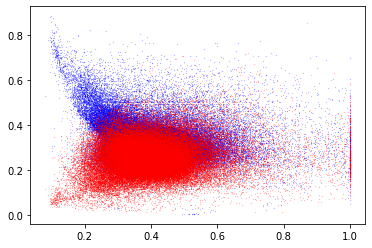

In [13]:
plt.scatter(uiks_predicted['turnout_predicted'], uiks_predicted['er_percent_predicted'], color='blue', s=0.01)
plt.scatter(uiks_predicted['turnout_predicted'], uiks_predicted['kprf_percent_predicted'], color='red', s=0.01)
plt.show()

In [14]:
er_real = uiks_predicted['er_predicted'].sum()
kprf_real = uiks_predicted['kprf'].sum()
voted_real = uiks_predicted['voted_predicted'].sum()
er_real_percent = er_real / voted_real
kprf_real_percent = kprf_real / voted_real
fake_votes = uiks_predicted['er'].sum() - uiks_predicted['er_predicted'].sum()

In [15]:
reg_true = pd.DataFrame()
for region in regions:
   region_data = uiks_predicted[uiks_predicted['region'] == region]
   kprf_total = region_data['kprf'].sum()
   er_total = region_data['er_predicted'].sum()
   voted = region_data['voted'].sum()
   kprf_percent = kprf_total/voted
   er_percent = er_total/voted
   uiks_predicted.loc[uiks['region'] == region, 'k-e'] = kprf_percent-er_percent
   if er_total>kprf_total:
       uiks_predicted.loc[uiks_predicted['region'] == region, 'color'] = 'blue'
   else:
       uiks_predicted.loc[uiks_predicted['region'] == region, 'color'] = 'red'
   reg_true = reg_true.append(pd.DataFrame({'name': region,'kprf':[kprf_total],'er':[er_total]}), ignore_index=True)
reg_true[reg_true['kprf']>reg_true['er']]
len(uiks_predicted['k-e'])

87810

In [17]:
fig = px.scatter_mapbox(uiks_predicted, #our data set
                        lat="lat",
                        lon="lon",
                        color='k-e',
                        range_color = (-0.5,0.5),
                        zoom=2,
                        width=1200, height=800,
                        center = {'lat':60,'lon':105},
                        title =  'После машинного обучения')
fig.update_layout(mapbox_style="open-street-map")
fig.update_traces(marker=dict(size=5))
fig.show(config={'scrollZoom': True})


fig.write_image("machine.png")

